In [7]:
import cv2
import matplotlib.pyplot as plt
%matplotlib inline

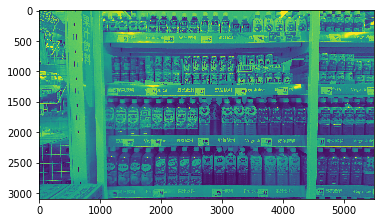

In [8]:
img = cv2.imread('./images/1-1.jpg')
gray1 = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY) 
plt.imshow(gray1)

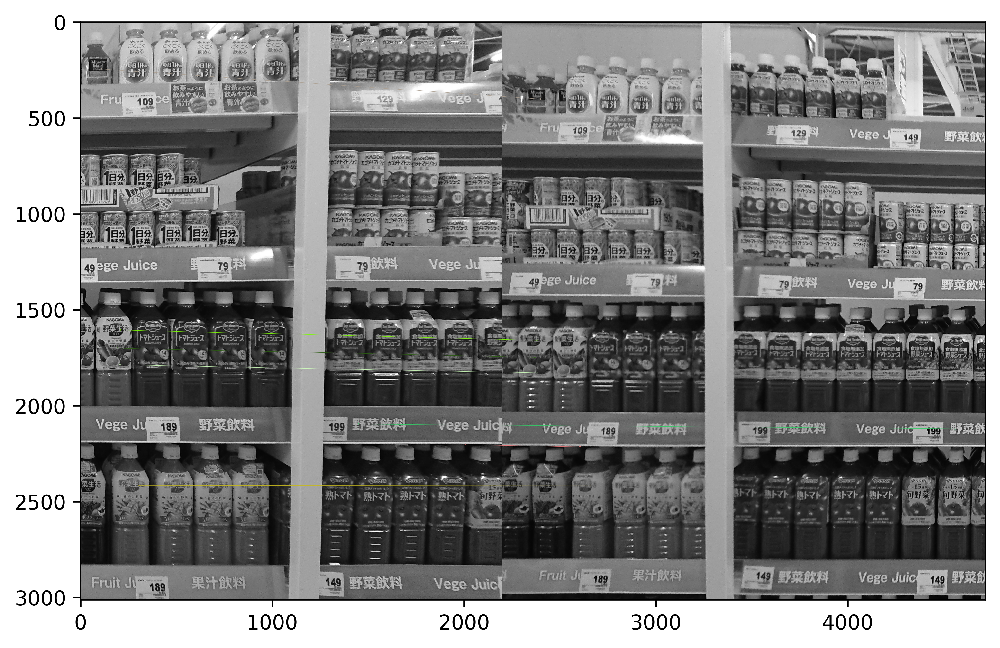

In [34]:
plt.figure(figsize=(8, 8), dpi=600)
img31 = cv2.imread('./images/1-1_.jpg')
gray1 = cv2.cvtColor(img31,cv2.COLOR_BGR2GRAY) 
img32 = cv2.imread('./images/2-1_.jpg')
gray2 = cv2.cvtColor(img32,cv2.COLOR_BGR2GRAY) 

akaze = cv2.AKAZE_create() # AKAZE検出器の生成
kp1, des1 = akaze.detectAndCompute(gray1,None) # 特徴量の検出と特徴量ベクトルの計算
kp2, des2 = akaze.detectAndCompute(gray2,None) 

bf = cv2.BFMatcher()    # BFMatcherオブジェクトの生成

matches = bf.knnMatch(des1, des2, k=2)  # Match descriptorsを生成
# matches = bf.match(des1, des2)
ratio = 0.5
good = []
for m, n in matches:
    if m.distance < ratio * n.distance:
        good.append([m])

# 対応する特徴点同士を描画
img3 = cv2.drawMatchesKnn(gray1, kp1, gray2, kp2, good[:150], None, flags=2)

plt.imshow(img3)

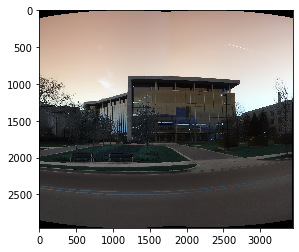

In [28]:
import sys
stitcher = cv2.Stitcher.create(cv2.STITCHER_PANORAMA)
gray1 = cv2.imread('./images/q11.jpg')
gray2 = cv2.imread('./images/q22.jpg')
status, pano = stitcher.stitch((gray1,gray2))
if status != cv2.Stitcher_OK:
    print("Can't stitch images, error code = %d" % status)
    sys.exit(-1)
plt.imshow(pano)


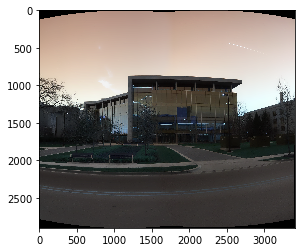

In [33]:
import sys
stitcher = cv2.Stitcher.create(cv2.STITCHER_PANORAMA)
gray1 = cv2.imread('./images/q11.jpg')
gray2 = cv2.imread('./images/q22.jpg')
status, pano = stitcher.stitch((gray1,gray2))
if status != cv2.Stitcher_OK:
    print("Can't stitch images, error code = %d" % status)
    sys.exit(-1)
plt.imshow(pano)

In [37]:
import cv2
import numpy as np
import sys

class Image_Stitching():
    def __init__(self) :
        self.ratio=0.9
        self.min_match=10
        #self.sift=cv2.xfeatures2d.SIFT_create()
        self.akaze=cv2.AKAZE_create()
        self.smoothing_window_size=800

    def registration(self,img1,img2):
        #kp1, des1 = self.sift.detectAndCompute(img1, None)
        #kp2, des2 = self.sift.detectAndCompute(img2, None)
        kp1, des1 = self.akaze.detectAndCompute(img1, None)
        kp2, des2 = self.akaze.detectAndCompute(img2, None)
        matcher = cv2.BFMatcher()
        raw_matches = matcher.knnMatch(des1, des2, k=2) # k:各クエリディスクリプタに対して求められるベストマッチの個数
        good_points = []
        good_matches=[]
        for m1, m2 in raw_matches:
            if m1.distance < self.ratio * m2.distance:
                good_points.append((m1.trainIdx, m1.queryIdx))
                good_matches.append([m1])
        img3 = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_matches, None, flags=2)
        cv2.imwrite('matching.jpg', img3)
        if len(good_points) > self.min_match:
            image1_kp = np.float32(
                [kp1[i].pt for (_, i) in good_points])
            image2_kp = np.float32(
                [kp2[i].pt for (i, _) in good_points])
            H, status = cv2.findHomography(image2_kp, image1_kp, cv2.RANSAC,5.0)
        return H

    def create_mask(self,img1,img2,version):
        height_img1 = img1.shape[0]
        width_img1 = img1.shape[1]
        width_img2 = img2.shape[1]
        height_panorama = height_img1
        width_panorama = width_img1 +width_img2
        offset = int(self.smoothing_window_size / 2)
        barrier = img1.shape[1] - int(self.smoothing_window_size / 2)
        mask = np.zeros((height_panorama, width_panorama))
        if version== 'left_image':
            mask[:, barrier - offset:barrier + offset ] = np.tile(np.linspace(1, 0, 2 * offset ).T, (height_panorama, 1))
            mask[:, :barrier - offset] = 1
        else:
            mask[:, barrier - offset :barrier + offset ] = np.tile(np.linspace(0, 1, 2 * offset ).T, (height_panorama, 1))
            mask[:, barrier + offset:] = 1
        return cv2.merge([mask, mask, mask])

    def blending(self,img1,img2):
        H = self.registration(img1,img2)
        height_img1 = img1.shape[0]
        width_img1 = img1.shape[1]
        width_img2 = img2.shape[1]
        height_panorama = height_img1
        width_panorama = width_img1 +width_img2

        panorama1 = np.zeros((height_panorama, width_panorama, 3))
        mask1 = self.create_mask(img1,img2,version='left_image')
        panorama1[0:img1.shape[0], 0:img1.shape[1], :] = img1
        panorama1 *= mask1
        mask2 = self.create_mask(img1,img2,version='right_image')
        panorama2 = cv2.warpPerspective(img2, H, (width_panorama, height_panorama))*mask2
        result=panorama1+panorama2

        rows, cols = np.where(result[:, :, 0] != 0)
        min_row, max_row = min(rows), max(rows) + 1
        min_col, max_col = min(cols), max(cols) + 1
        final_result = result[min_row:max_row, min_col:max_col, :]
        return final_result



True

In [43]:
img1 = cv2.imread('images/1-1.jpg')
img2 = cv2.imread('images/2-1.jpg')
final=Image_Stitching().blending(img1,img2)
cv2.imwrite('panorama.jpg', final)


TypeError: imshow() missing required argument 'mat' (pos 2)

In [47]:
img1 = cv2.imread('images/bottle_up_.jpg')
img2 = cv2.imread('images/bottle_down_.jpg')
final=Image_Stitching().blending(img1,img2)
cv2.imwrite('panorama.jpg', final)

True

In [48]:
img1 = cv2.imread('images/3-1__.jpg')
img2 = cv2.imread('images/3-2__.jpg')
final=Image_Stitching().blending(img1,img2)
cv2.imwrite('panorama.jpg', final)

True

In [65]:
class ImgStitching():
    def __init__(self) :
        self.ratio=0.9
        self.min_match=10
        #self.sift=cv2.xfeatures2d.SIFT_create()
        self.akaze=cv2.AKAZE_create()
        self.smoothing_window_size=800

    def registration(self,img1,img2):
        #kp1, des1 = self.sift.detectAndCompute(img1, None)
        #kp2, des2 = self.sift.detectAndCompute(img2, None)
        kp1, des1 = self.akaze.detectAndCompute(img1, None)
        kp2, des2 = self.akaze.detectAndCompute(img2, None)
        matcher = cv2.BFMatcher()
        raw_matches = matcher.knnMatch(des1, des2, k=2) # k:各クエリディスクリプタに対して求められるベストマッチの個数
        good_points = []
        good_matches=[]
        for m1, m2 in raw_matches:
            if m1.distance < self.ratio * m2.distance:
                img1X, img1Y = [list(map(int, kp1[m1[0].queryIdx].pt))][0] # image1の座標を取得 
                img2X, img2Y = [list(map(int, kp2[m1[0].trainIdx].pt))][0] # image2の座標を取得
                if img1Y > img2Y:
                    good_points.append((m1[0].trainIdx, m1[0].queryIdx))
                    good_matches.append([m1[0]])
        img3 = cv2.drawMatchesKnn(img1, kp1, img2, kp2, good_matches, None, flags=2)
        cv2.imwrite('matching.jpg', img3)
        if len(good_points) > self.min_match:
            image1_kp = np.float32(
                [kp1[i].pt for (_, i) in good_points])
            image2_kp = np.float32(
                [kp2[i].pt for (i, _) in good_points])
            H, status = cv2.findHomography(image2_kp, image1_kp, cv2.RANSAC,5.0)
        return H

    def create_mask(self,img1,img2,version):
        height_img1 = img1.shape[0]
        width_img1 = img1.shape[1]
        width_img2 = img2.shape[1]
        height_panorama = height_img1
        width_panorama = width_img1 +width_img2
        offset = int(self.smoothing_window_size / 2)
        barrier = img1.shape[1] - int(self.smoothing_window_size / 2)
        mask = np.zeros((height_panorama, width_panorama))
        if version== 'left_image':
            mask[:, barrier - offset:barrier + offset ] = np.tile(np.linspace(1, 0, 2 * offset ).T, (height_panorama, 1))
            mask[:, :barrier - offset] = 1
        else:
            mask[:, barrier - offset :barrier + offset ] = np.tile(np.linspace(0, 1, 2 * offset ).T, (height_panorama, 1))
            mask[:, barrier + offset:] = 1
        return cv2.merge([mask, mask, mask])

    def blending(self,img1,img2):
        H = self.registration(img1,img2)
        height_img1 = img1.shape[0]
        width_img1 = img1.shape[1]
        width_img2 = img2.shape[1]
        height_panorama = height_img1
        width_panorama = width_img1 +width_img2

        panorama1 = np.zeros((height_panorama, width_panorama, 3))
        mask1 = self.create_mask(img1,img2,version='left_image')
        panorama1[0:img1.shape[0], 0:img1.shape[1], :] = img1
        panorama1 *= mask1
        mask2 = self.create_mask(img1,img2,version='right_image')
        panorama2 = cv2.warpPerspective(img2, H, (width_panorama, height_panorama))*mask2
        result=panorama1+panorama2

        rows, cols = np.where(result[:, :, 0] != 0)
        min_row, max_row = min(rows), max(rows) + 1
        min_col, max_col = min(cols), max(cols) + 1
        final_result = result[min_row:max_row, min_col:max_col, :]
        return final_result


In [66]:
#from imgstitching import ImgStitching
img1 = cv2.imread('images/3-1__.jpg')
img2 = cv2.imread('images/3-2__.jpg')
final=ImgStitching().blending(img1,img2)
cv2.imwrite('panorama.jpg', final)

TypeError: 'cv2.DMatch' object is not subscriptable